# Microsoft Fabric Notes

These notes will function as a referance during my studies on Nikolai's video content. I will add snippets of code as required for the projects and module hands-on training. 


Screenshots of the course and any workshop details may be included. 

# Workspaces

A container for resources such as a Lakehouse. Similar to a resource group in Microsoft Azure.

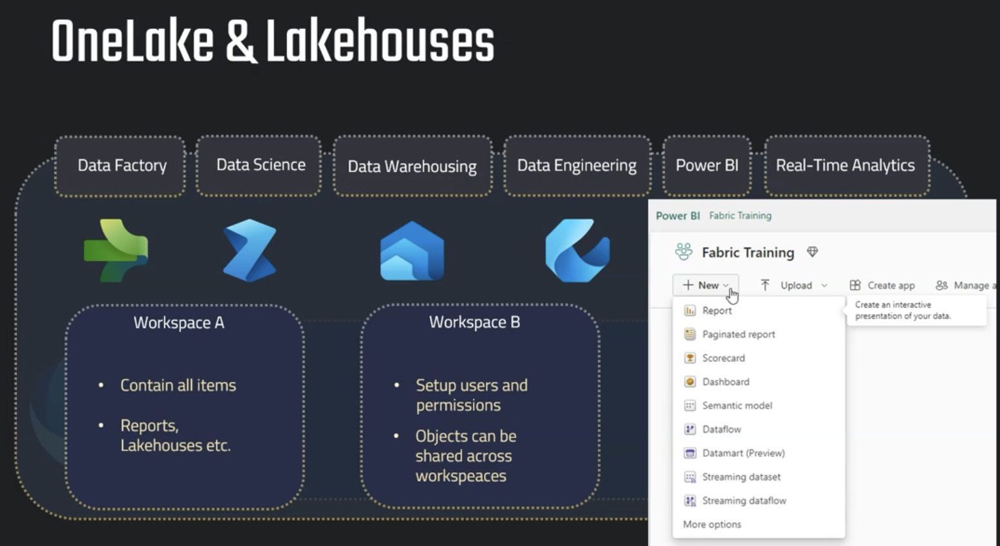

Different resources can be provisioned to different worksapces using the different *experiences* such as Power BI experience and deploying reports or the Data Engineering experience to deploy Lakehouses. 

Resources may be shared across workspaces as necessary. 

Every user gets a *My Workspace* that is created with their account considered the default private worksapce. 

If Fabric resources are to be used on a workspace, you must go to *Advanced* Settings and enable the access.

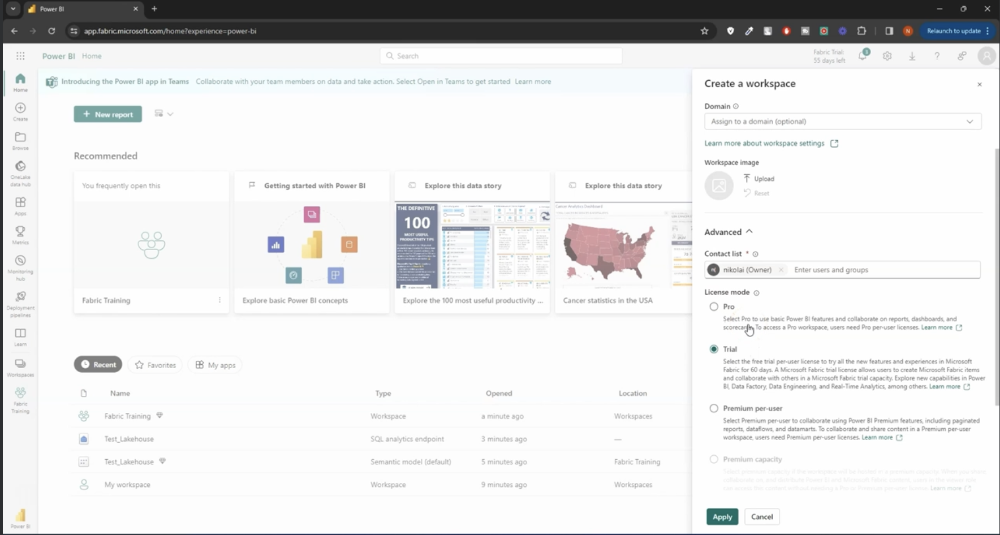



# Lakehouses

Created used in Data Engineering experience.

One location for Delta Tables and files. Storing, managing and analyzing. 
* Files can be semi structured or unstructured.


SQL endpoint is created with lakehouses for read-only access. This is created to connect other tools. 

Power BI Reporting Model is creating along with all lakehouses for default Power BI reporting.

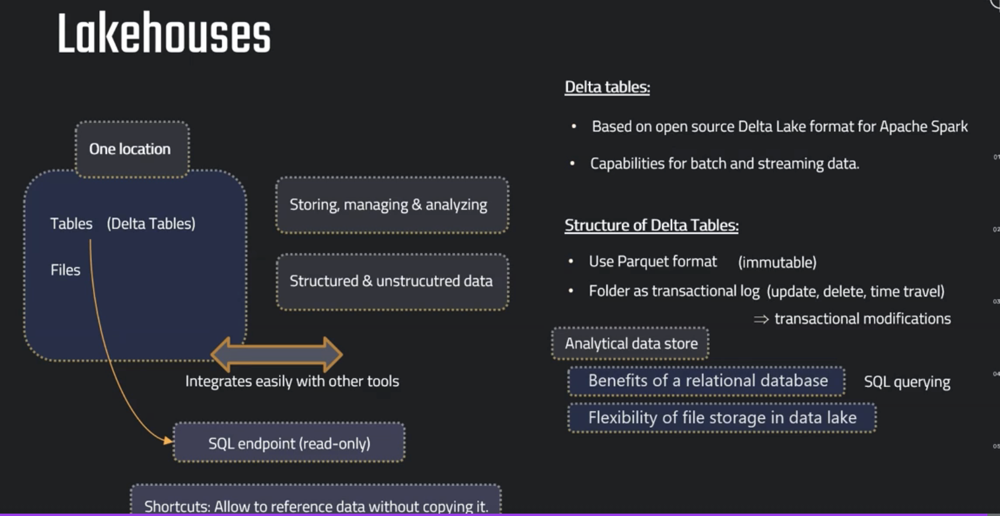

**Creating the Lakehouse**


Under the workspace desired, select *New* and select Lakehouse from the dropdown menu.

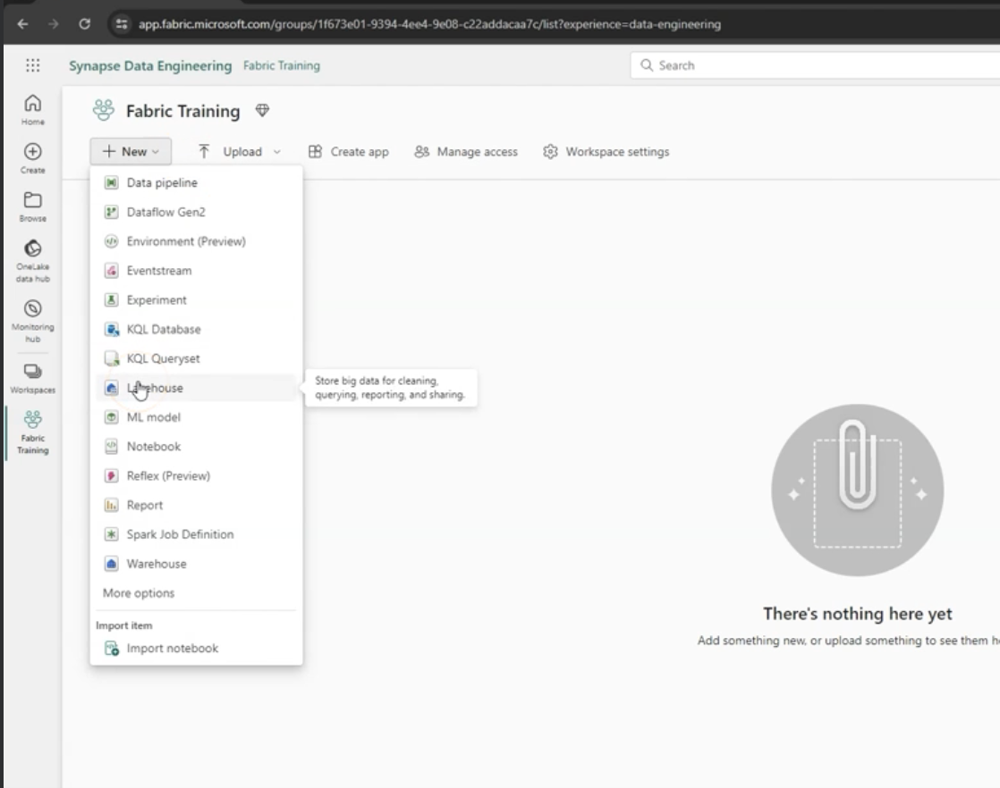

Creating a Subfolder for each piece of data is recommended.


## Loading Data Into a Lakehouse 

### Loading a File

Click on the folder and select *upload file*. 

Depending on the file type, a preview will be available in the lakehouse after upload. 

After upload, clicking on the file allows you to *Load to table*. 

For common files such as CSV this is possible. For semi-structured data such as JSON, files must first go through a Data Flow process before a table is created. 


### Delta Tables During Data Loadsets

Delta tables are visible under the Tables folder structure. Based on the table name, the column (schema) structure is viewabl similar to a RDBMS. Clicking on the table ellipses allows direct access to the table files

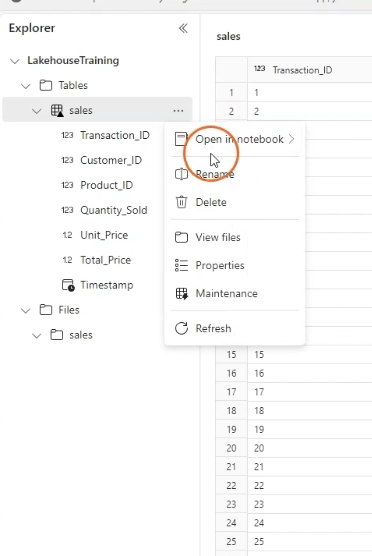

files included are the tables under the *parquet* format and the data log folder. 

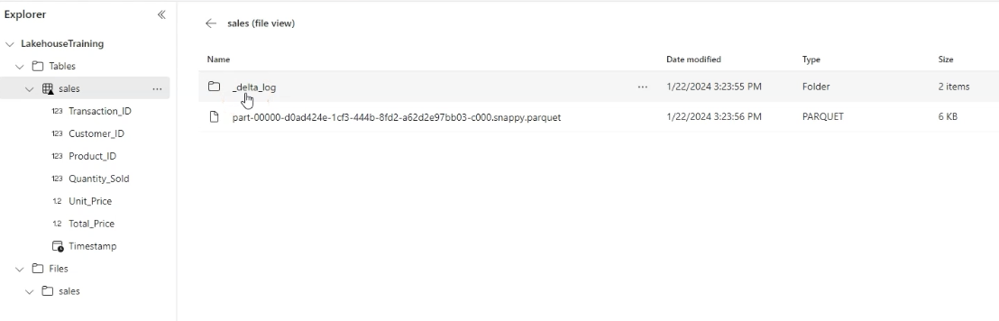

Data in the log transactions are stored in the data log in JSON format. Due to the size and amount of data changes that may occur. Allows multiple copies and changes to the data.

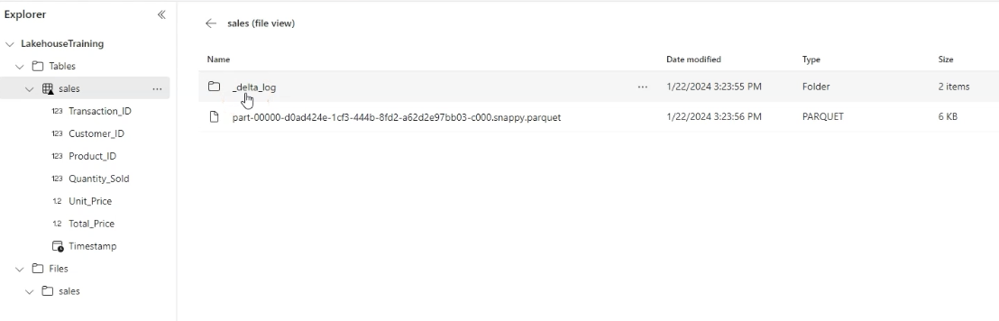



### Dataflow Gen 2

Utilizes the power query functionality. The Data sources are available for almost all types such as API, excel, Azure resources, and Fabric specific resources such as Lakehouse. 

Utilizing the Lakehouse creates a connector specific to the workspaces required. 

*Example of Query Editor For JSON Load in Lakehouse*
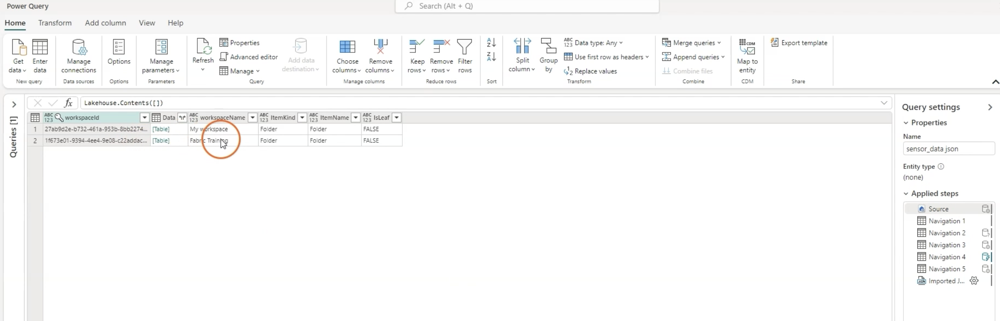


During the import process, additional transormations may be required. If a JSON isn't parsed correctly or if conversion from a base data type (such as a list) was not automatically made to a table

*Converting List to Table*
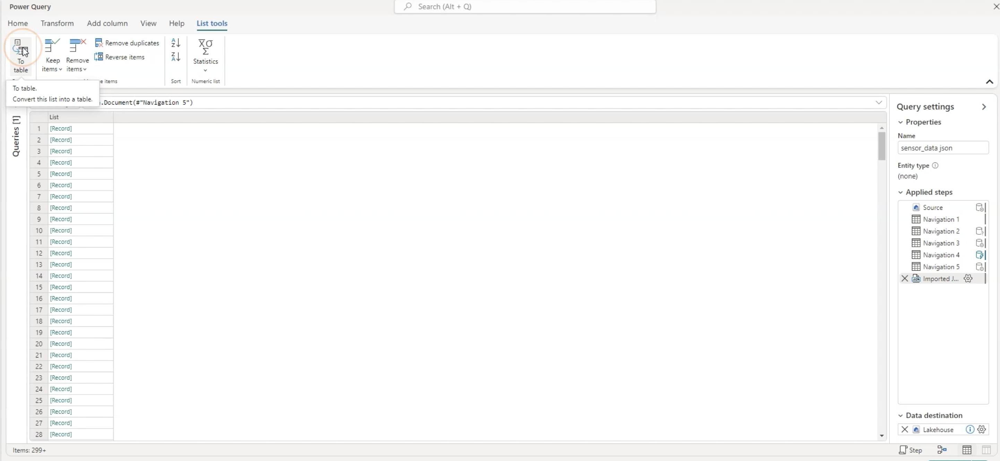

After conversion to a table, additional columns are shown within the Query Editor icon for columns if you wish to set keys within a nested json as column values.

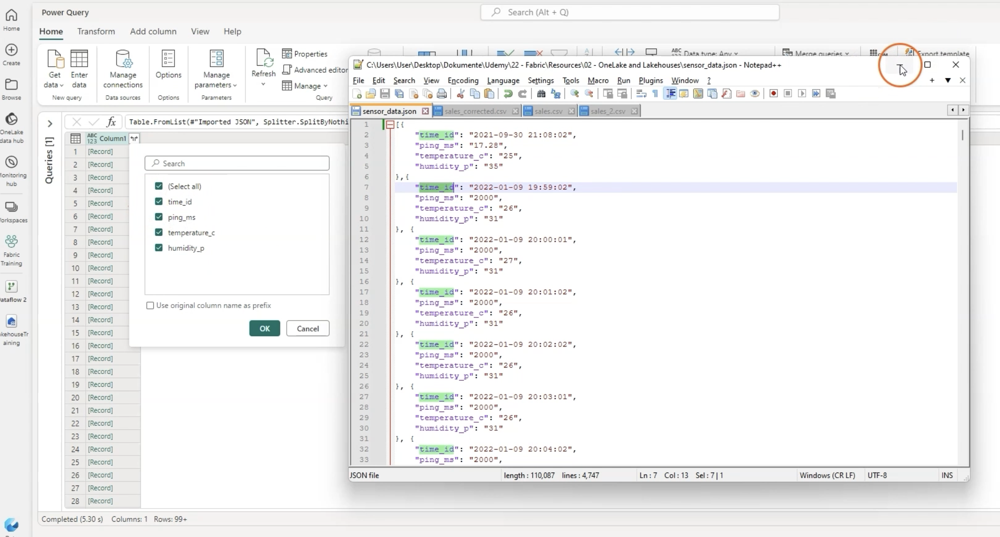

**Detecting and Setting Data Types**

Once data is within a table, data types by column can be adjusted on a per column level OR by selecting the specific columns and using the built in Datatype detection method under the Transform tab.

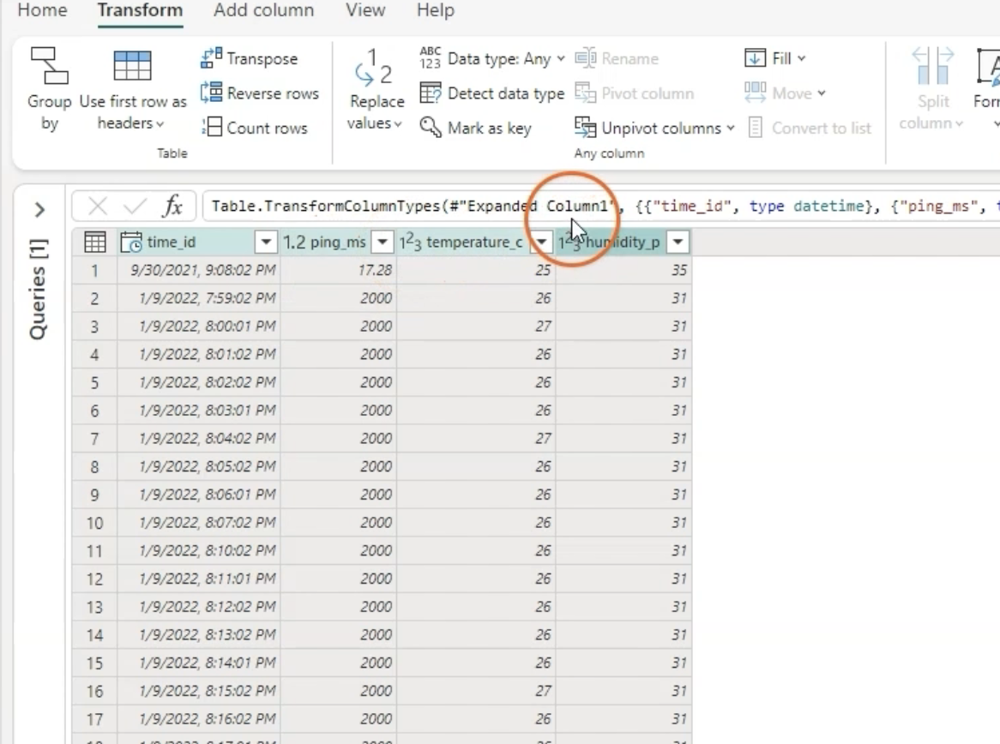

**Confirming and Configuring Destination**

After Data is cleaned to the standard required, the bottom right corner new Publish shows the automatically detected destination. If a change in destination or change in some of the properties is required, this is managed via the "Gear" icon.

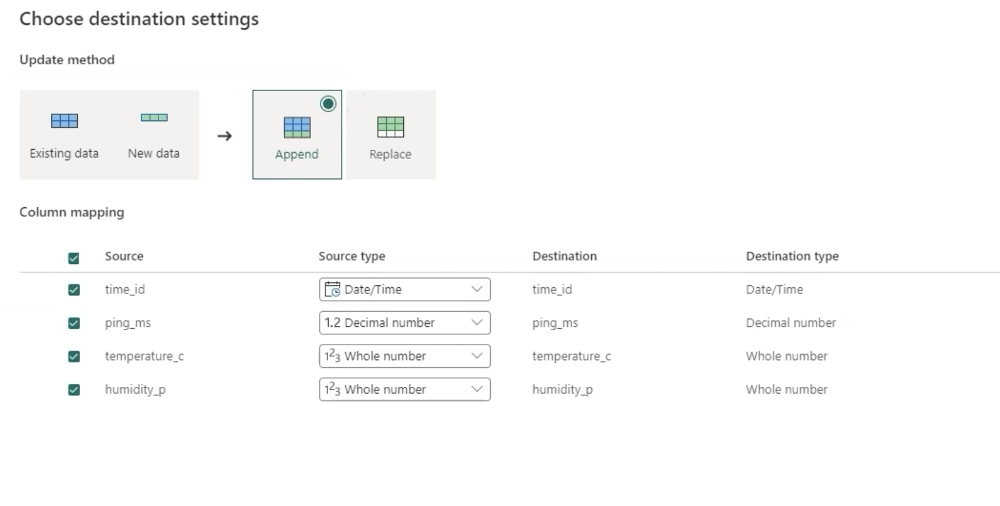


After the data is prepared, publish the dataflow and confirm that data is processing.

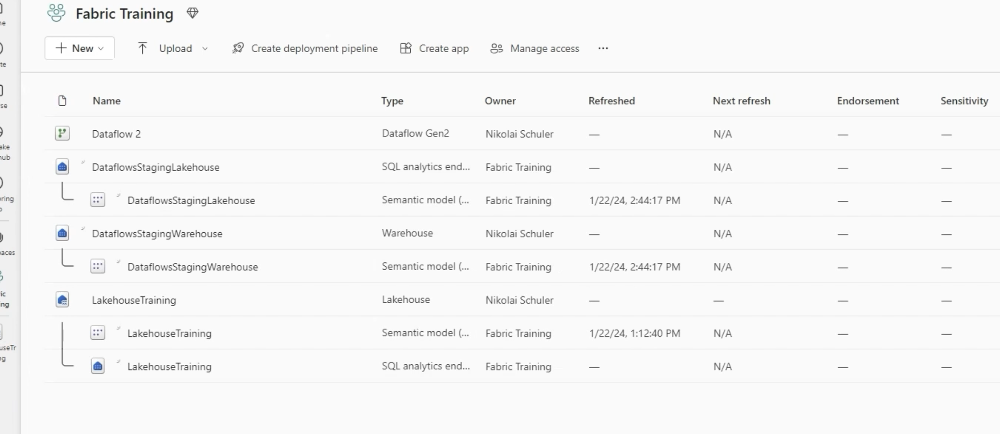

If a dataflow is expected to be reused, reviewing the dataflow allows a scheduled refresh for any new data.

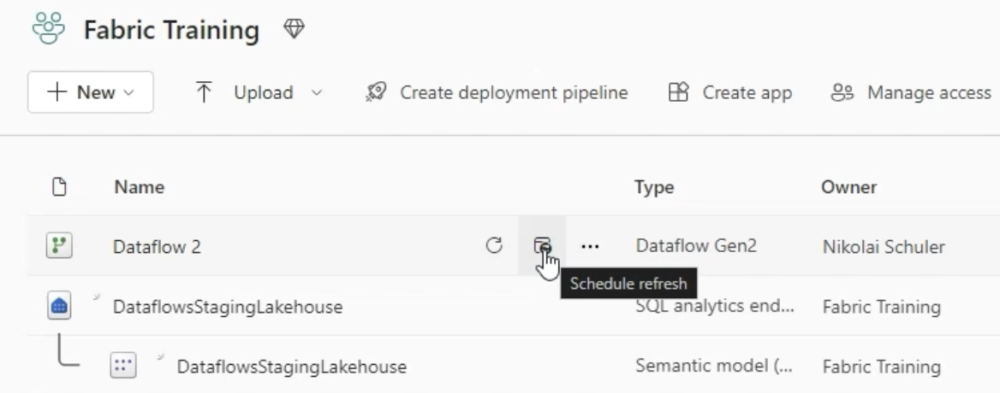



### DataLake Explorer

A windows tool that can be downloaded from Microsoft that functions in a similar fashion to onedrive where data is synced, and files can be viewed within File Explorer.

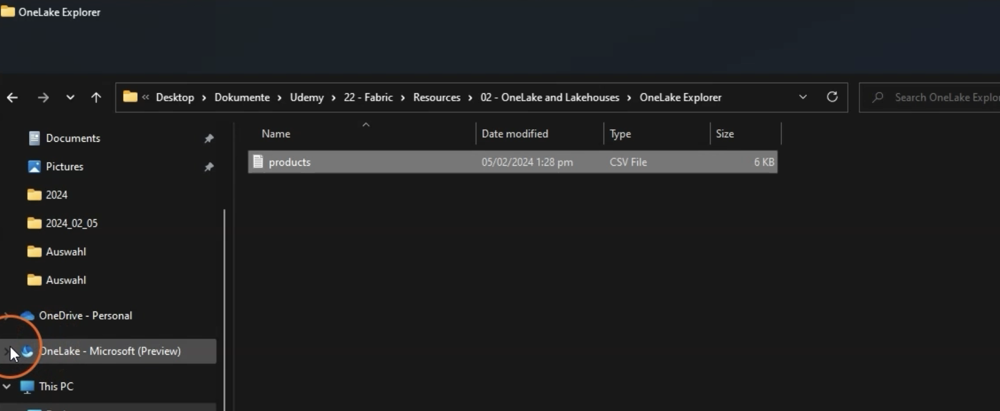

Not commonly used but available for simple uploads.


### SQL Analytics Endpoint

Always created alongside a Lakehouse.

Viewed in the Data Engineering view, and can be directly used within the SQL Endpoint view (or by clicking directly on the SQL endpoint)

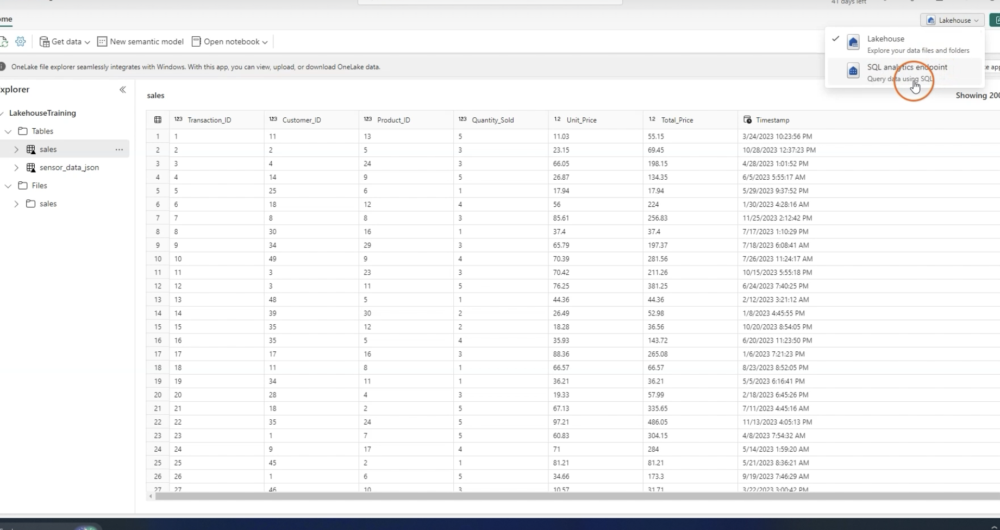

Accessing the SQL endpoint directly can be made using the endpoint connection string.
* Allows access via SSMS

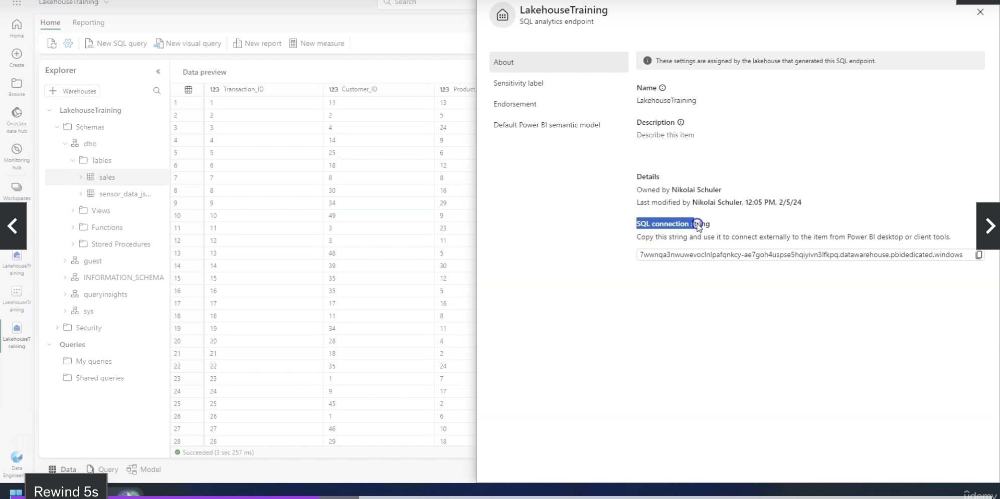

### Build Visual Queries

A GUI alternative to using SQL queries, similar to power query. 

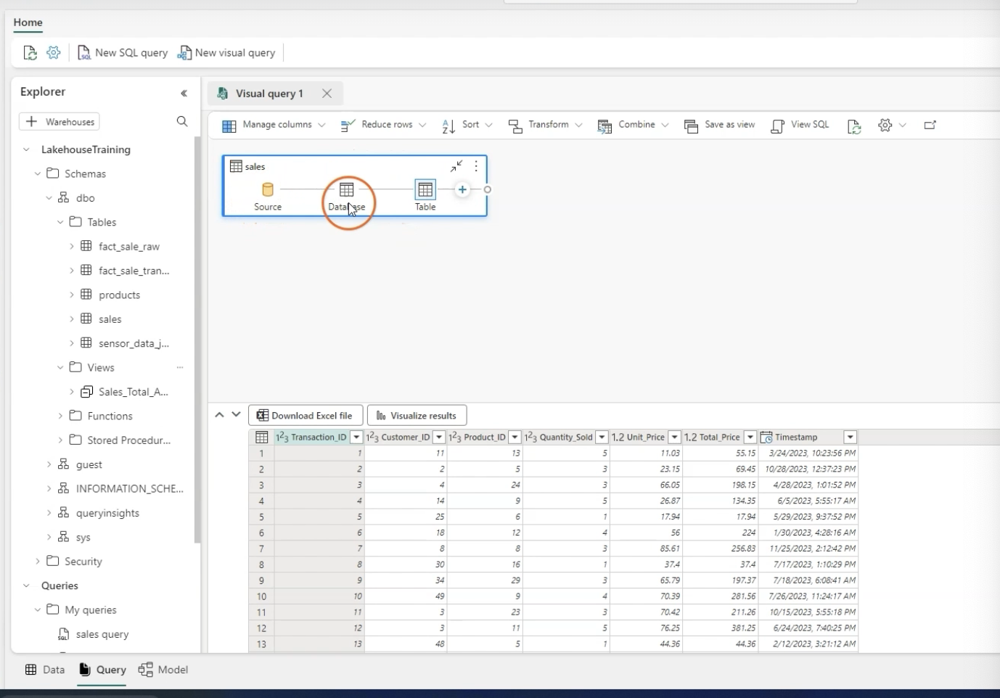


Every action taken will create a *step* in the visual query queue for future use or step by step instructions. If multiple visual queries are created they can be merged together if needed. 

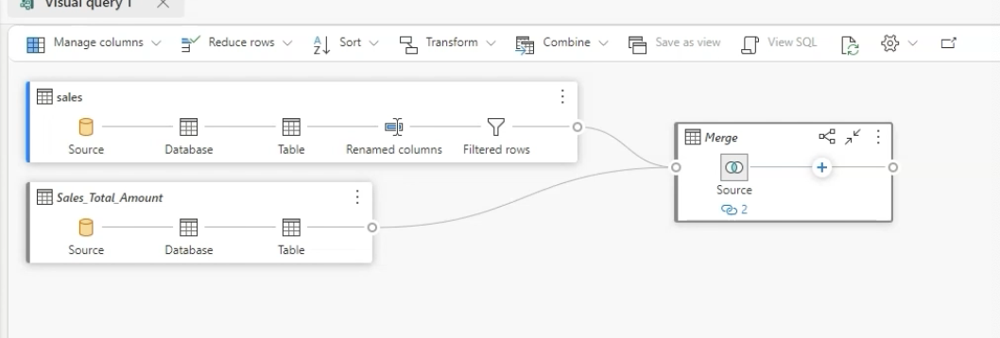

Under *Saved Queries* you can save visual queries alongside saved SQL queries.


### Creating Shortcuts


A foundational advantage of Microsoft Fabric, allowing data to be referanced without duplicating data and saving to Fabric or duplicating from another Lakehouse. 

Creating the shortcut can be found under the Data Engineering or Data Lakehouse experience. Selecting the *Get Data* option allows you to create the shortcut.

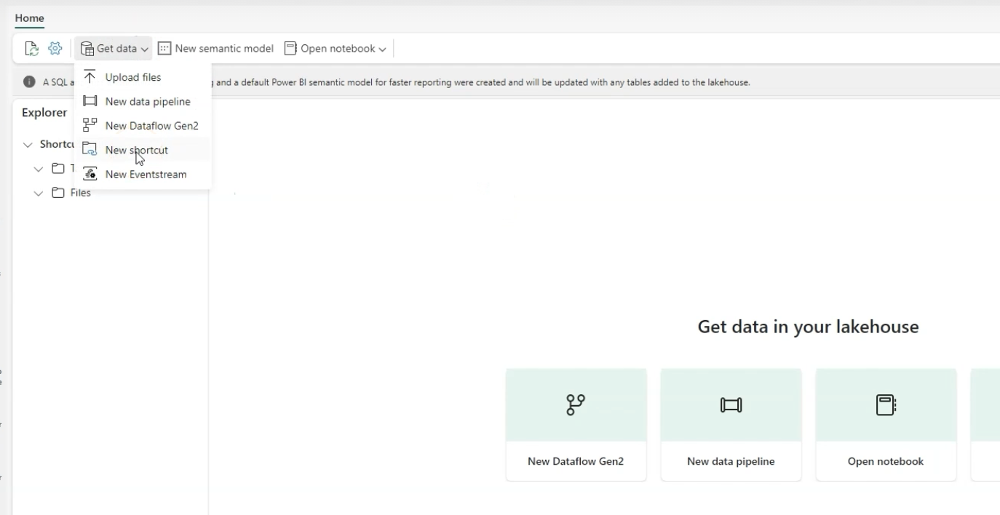

*Creating a shortcut to a Lakehouse Table*

Creating the shortcut requires selecting the available Lakehouse and the specific table folders associated with the delta tables. 

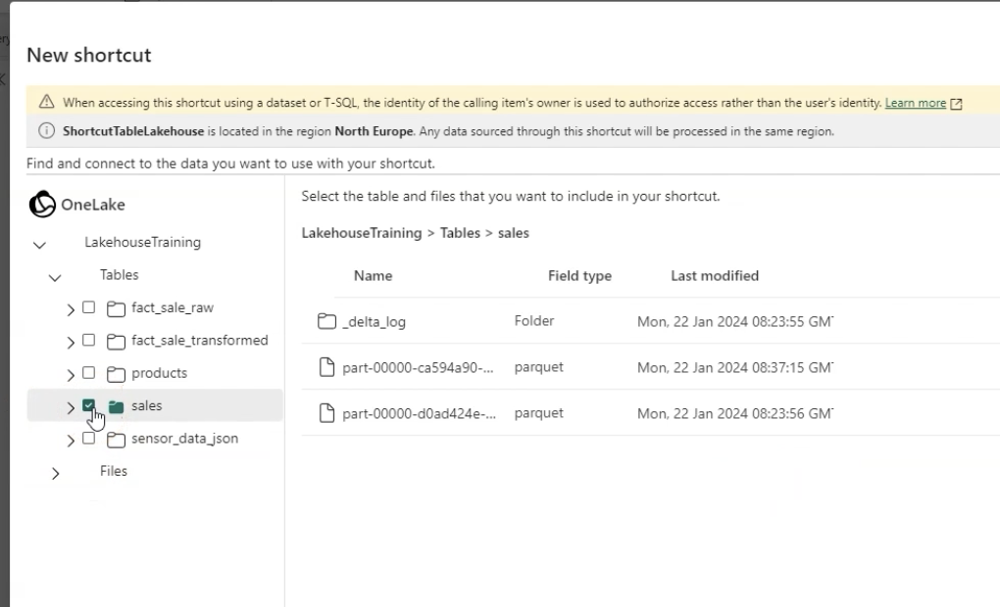

Post shotcut deployment, the same features and views are available as if the data was directly saved within the Lakehouse. 
* SQL Endpoint Queries
* Power BI Reporting



## Sharing and Access

Sharing can be managed on an item level or the entire Lakehouse. When sharing a Lakehouse, additional properties can be shared via SQL Enpoint, semantec models (Power BI), and Spark. 


# Power BI and Semantic Models


## Semantic Models

All lakehouses have at least one semantic model creating during the lakehouse creation process. Additional semantic models can be created in addition to the default model. 

Reports all use the semantic model(s) within the Lakehouse, including any reports created "from" any SQL endpoints.
* Selecting *Create report* on the drop down menu from the SQL endpoint uses the semantic model

*Semantic Model Selected Under Synapse Data Engineering*

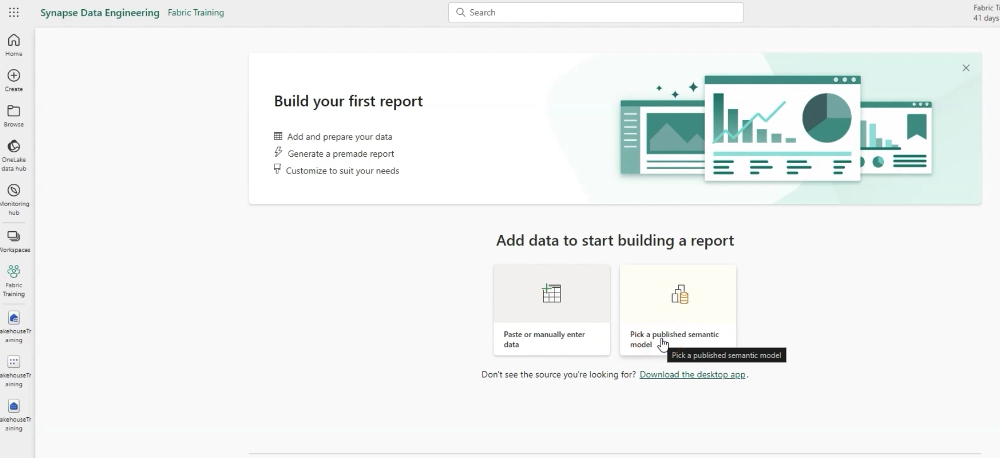


The semantic model in Fabric is the *fast-path* to load data from a lake straight to Power BI engine without the need to utilize the DirectQuery or Import method previously assigned to Power BI. 

*DirectQuery Mode*
Queries the data at the source, but can be slow. Avoids the copy requirements of import mode.

*Import Mode*
Fast because the data is cached and optimized for DAX and MDX report queries without translatting and passing SQL. Power BI engine must first copy new data into the model during refresh. 

*Direct Lake Mode*
Loads the data directly from OneLake. There is no translation from DAX or MDX to other query languages which results in similar performance as *Import Mode*


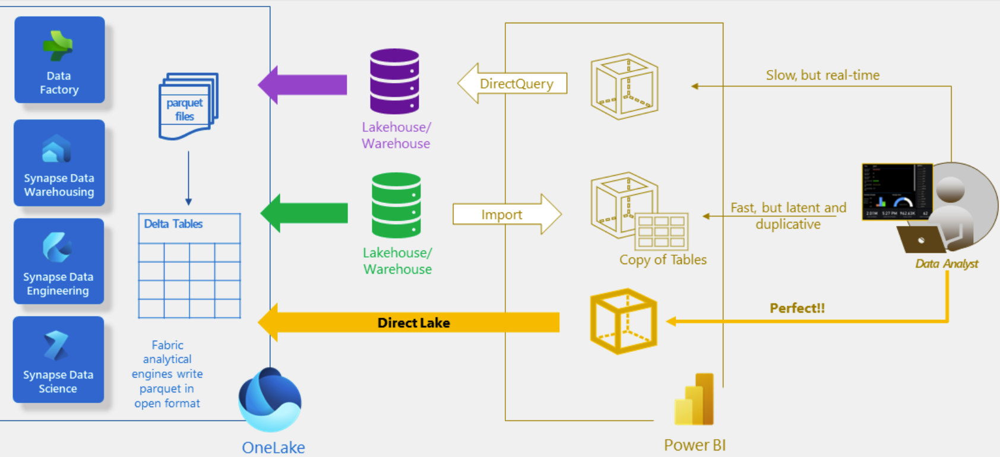




### Relationship In Semantic Models

A semantic model allows multiple tables in association. This is created using the *New Semantic Model* option in the Lakehouse menu and adding the associated tables. 

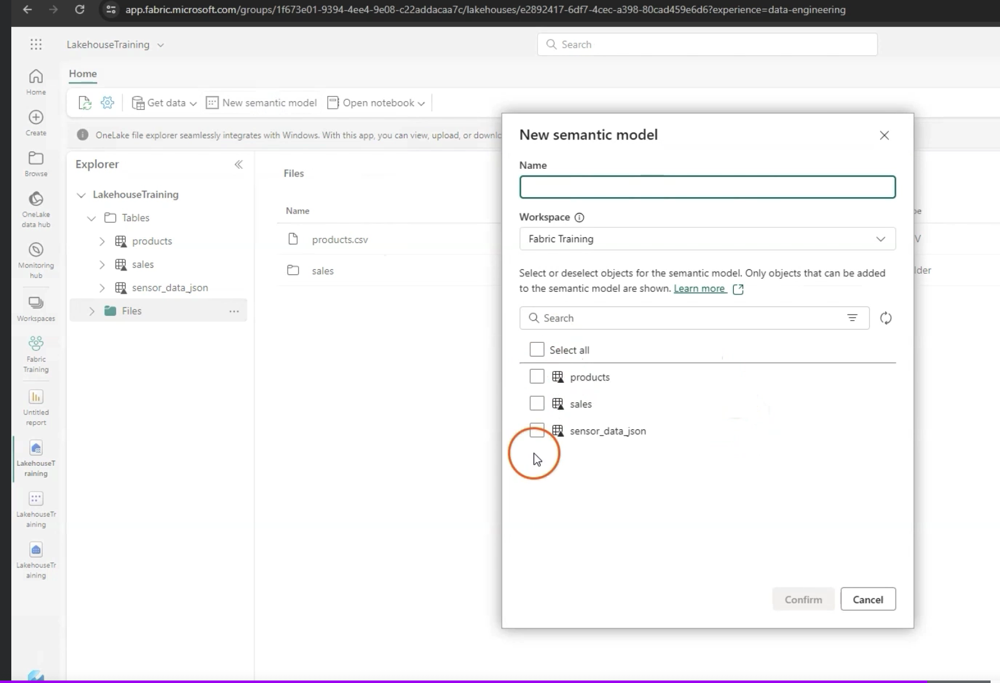

Creating relationships between the tables can also occur within the SQL endpoint. Drag and drop allows for relationships to be built.

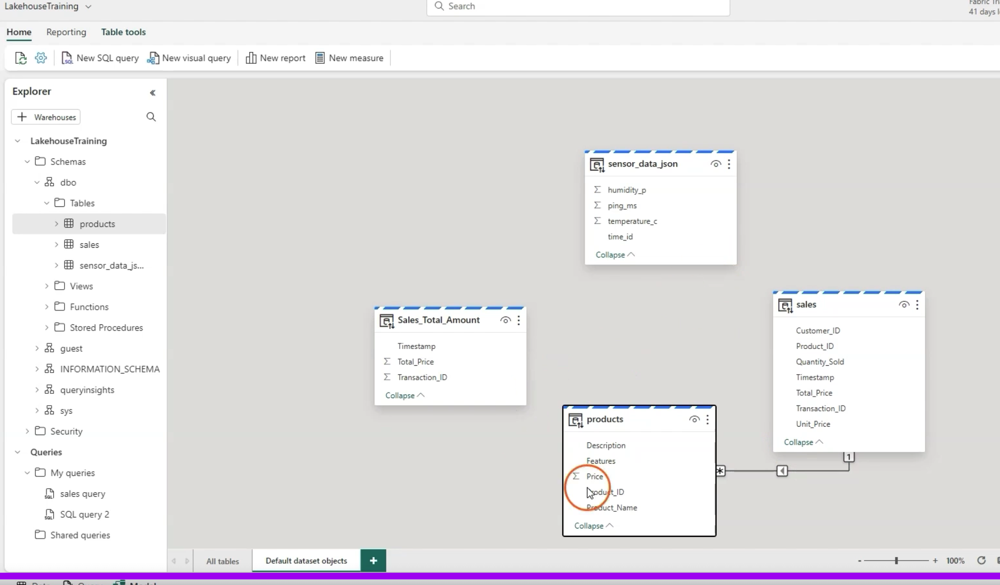



### Creating a new Report via Power BI


Creating a new report is based on the workspace the report is stored (semantic model access context). The data will be immediately available on the Data panel and can be dragged and dropped into the required visualizations. 

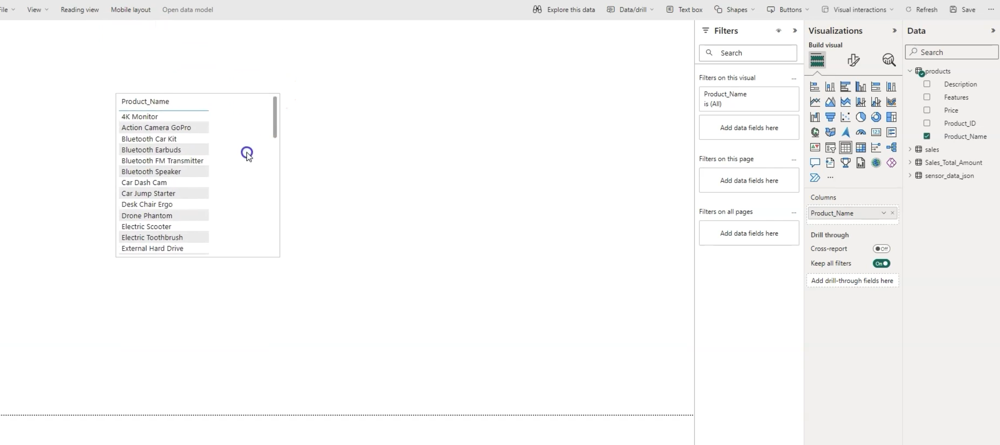


### Creating a new Semantic Model

Under the lakehouse, creating this directly under the menu for new semantic model. All semantic models outside of the default model can be filtered so that it only includes access to the data required. 

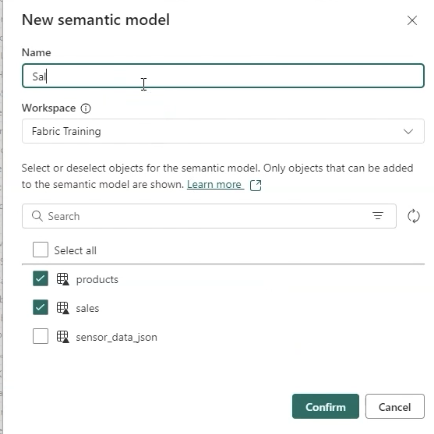


If the data contains multiple sources/tables, the relationships will need to be defined. 

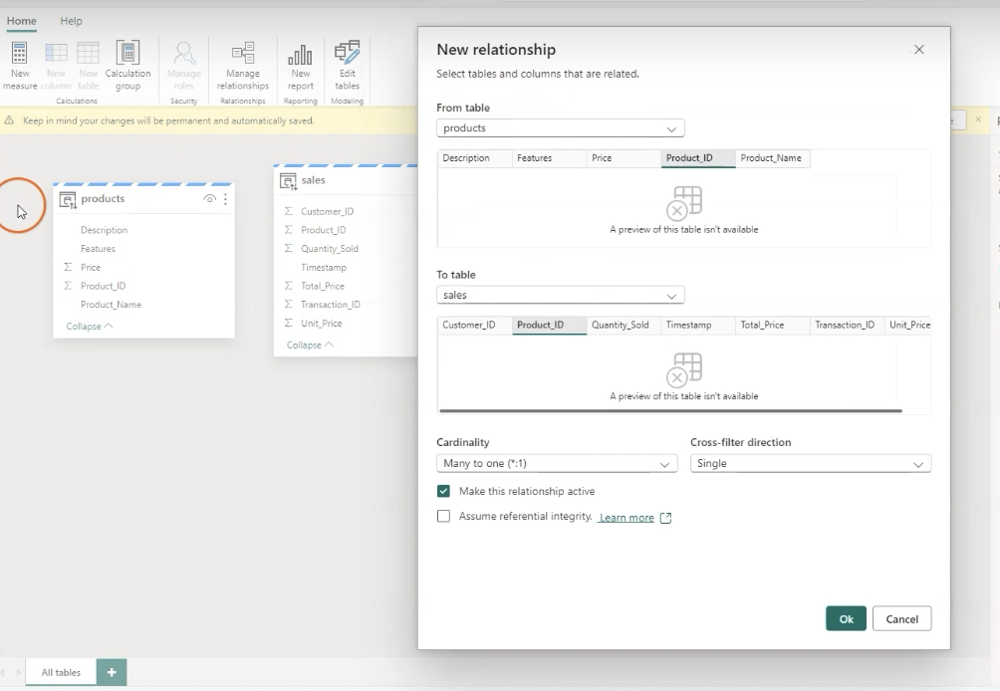


### Creating Measures


Available under the data modeler GUI or data viewer. A **measure** is an analytics function of Power BI such as sums, averages, minimums, maximums, and counts. The results of measures are dynamic based on the interaction and loaded data within the report. 


Within semantic models new columns or calculated columns cannot be created, so measures are created for interactivity. 

Once they are created and the associated function(s) assigned, the new function will show within the table for use in Power BI.


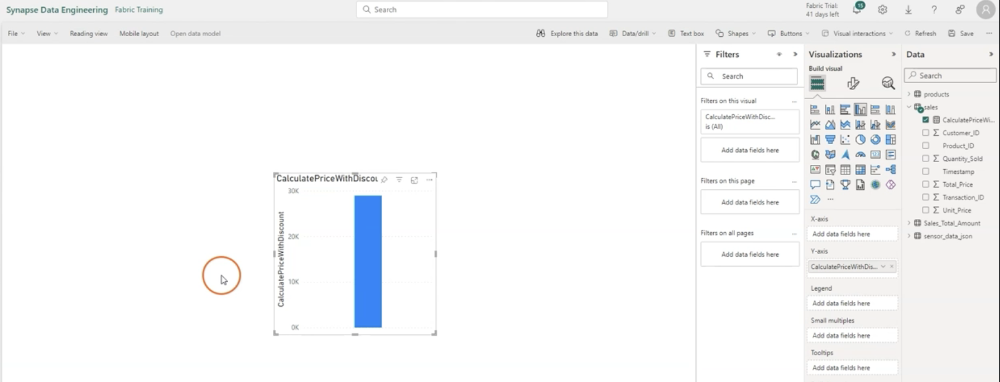

### Connect SQL Endpoint directly with Power BI

Alternative to usign the optimized semantic model. Within Power BI, selecting the datasource allows access via the SQL endpoint which will require authentication (Power BI Desktop) and the endpoint link. 

Utilizes the native *Import Mode*.




## Publishing Apps for Power BI

The functionality is within the Power BI page or the Data Engineering experience under the workspace desired. A single app is available **per workspace**. 

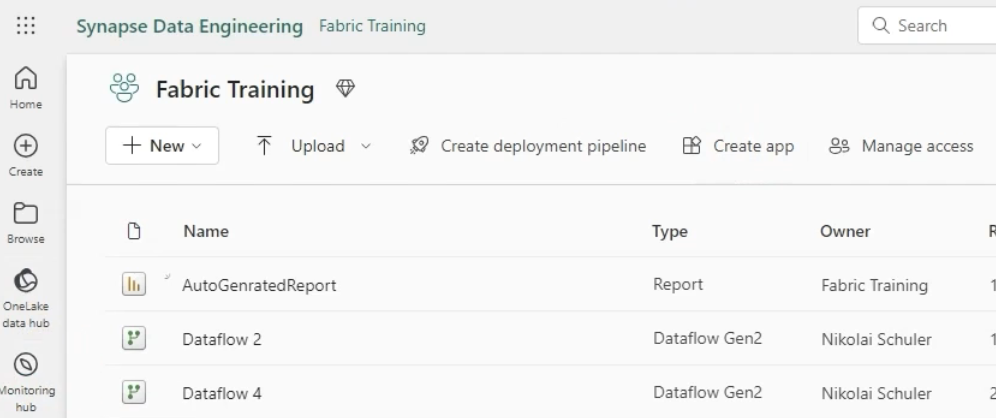


When creating the app, the content selection is based on either:
1. A Power BI report within the workspace
2. A link to other content


Each app may have multiple sections where different reports are organized.

Very similar to other Microsoft projects, sharing is based on invitation page where users and / or the entire organization can be invited.

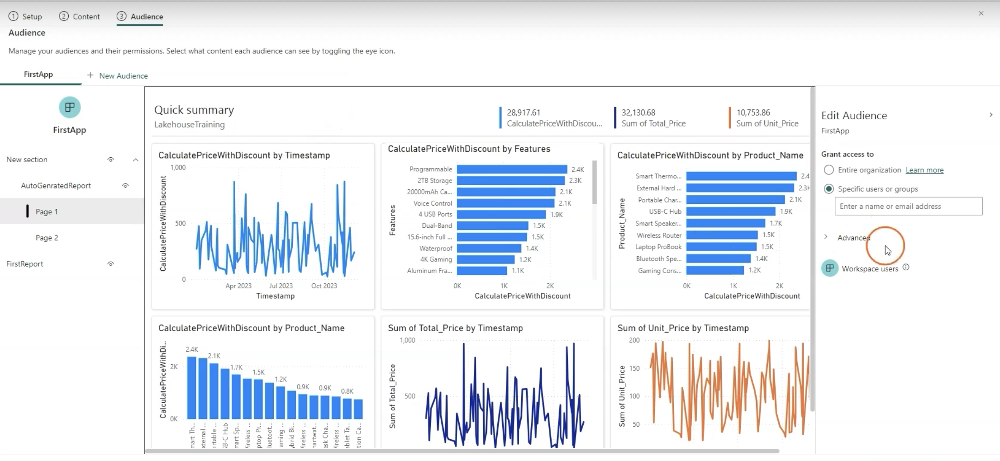


Different audiences can be restricted to different sections or reports based on the security group/invite process where different audience tabs are created. 

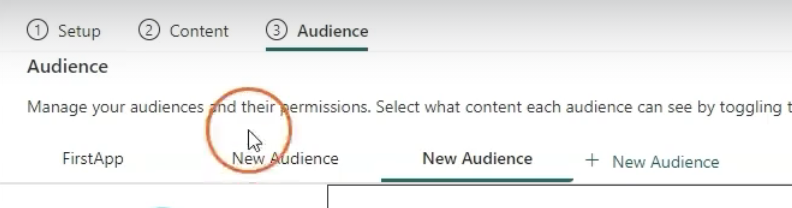


If any changes need to be made, go to the workspace and use the update app button that replaces the create app button. Any modifications made within the app must deployed this way. 

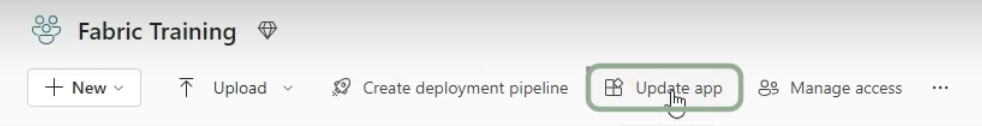


If there is ever a requirement that forces unpublishing / deleting an app, it is hidden in the "additional options" on the workspace menu bar. Unpublish the app using the unpublish button. The previous update app button will then change back to the create app button. 






# Azure Data Factory


## Azure Data Factory and Data Pipelines

The main purpose of the Dataflow Gen 2 is the **transformation** of data. The Data pipeline is more for workflow orchestration and ingestion at scale. The data pipeline is under the ADF experience. 
* Data pipelines can be found under the Data Engineering experience as well. 


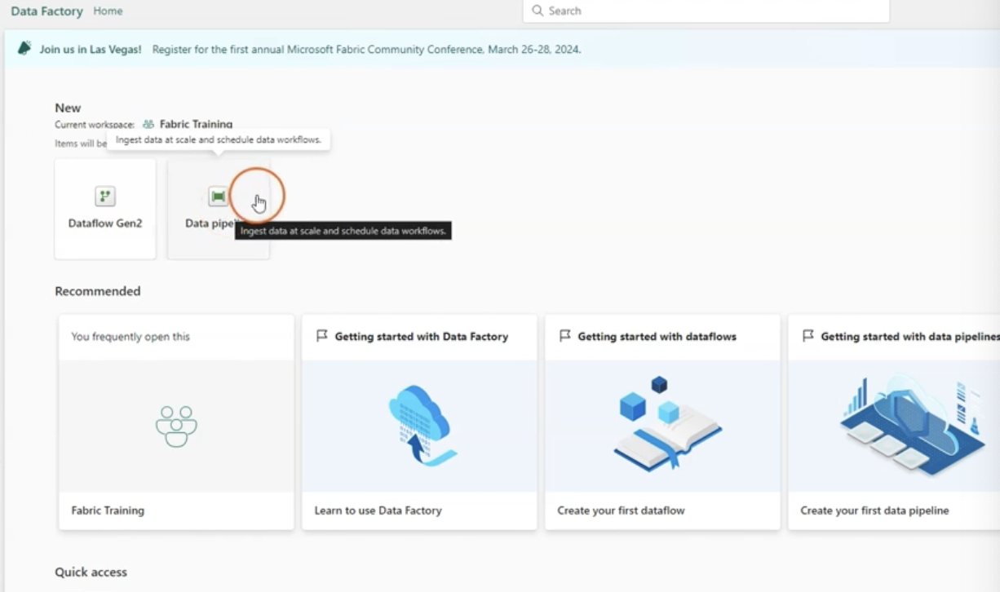


Using Fabric, ingesting the data aligns with the **Extract, Load Transform** methodology versus the traditional **Extract, Transform, Load**. 

When creating a new Data Pipeline, you can use the guided setup within the GUI which provides multiple options that are commonly used when loading into Fabric.

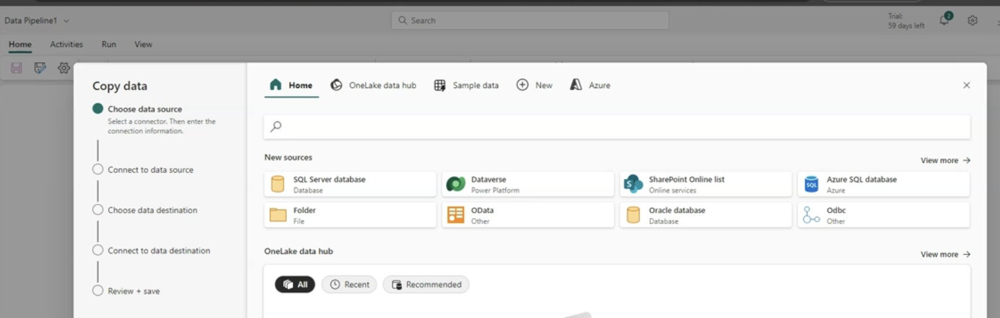

Depending on the data sources, data may be loaded immediately or after the pipeline is completed.


*Example of Blob loading connection*
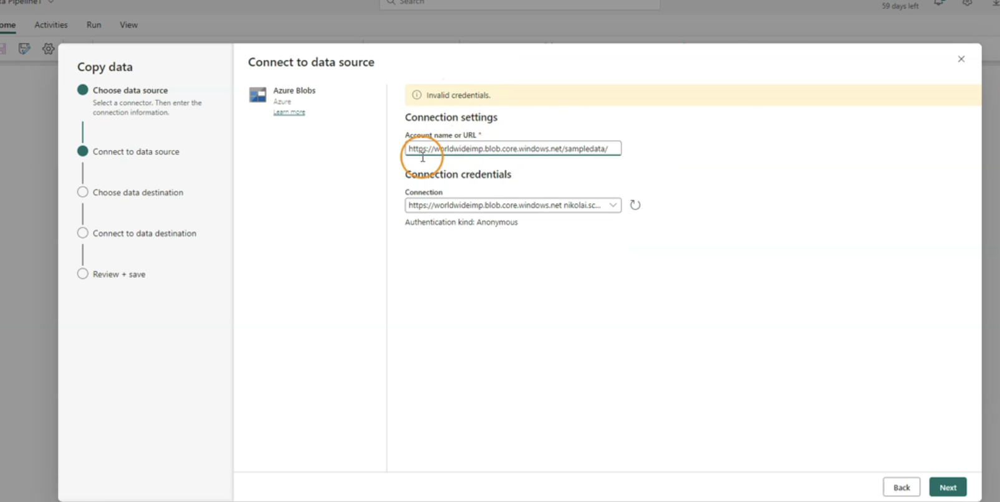

*Example of Data Pipeline Loading DAta to Table*
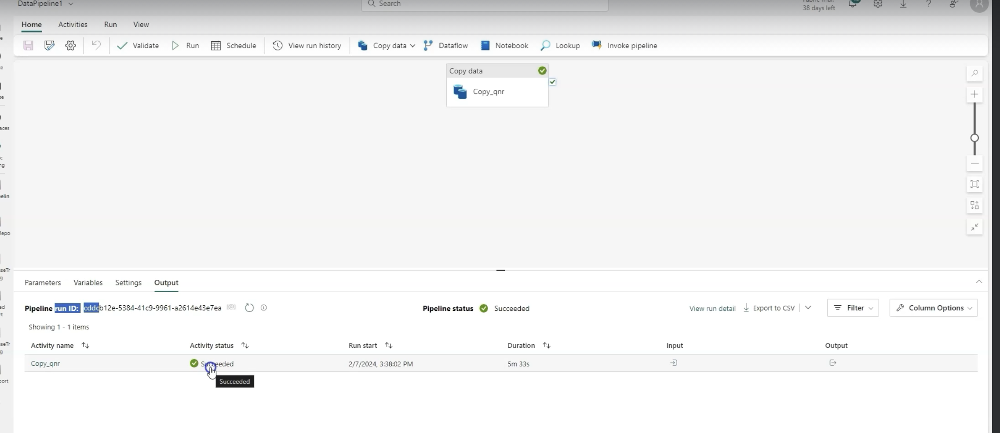




After loading a Pipeline Gen 2 can be connected via the GUI to continue working with the data, transforming the data.


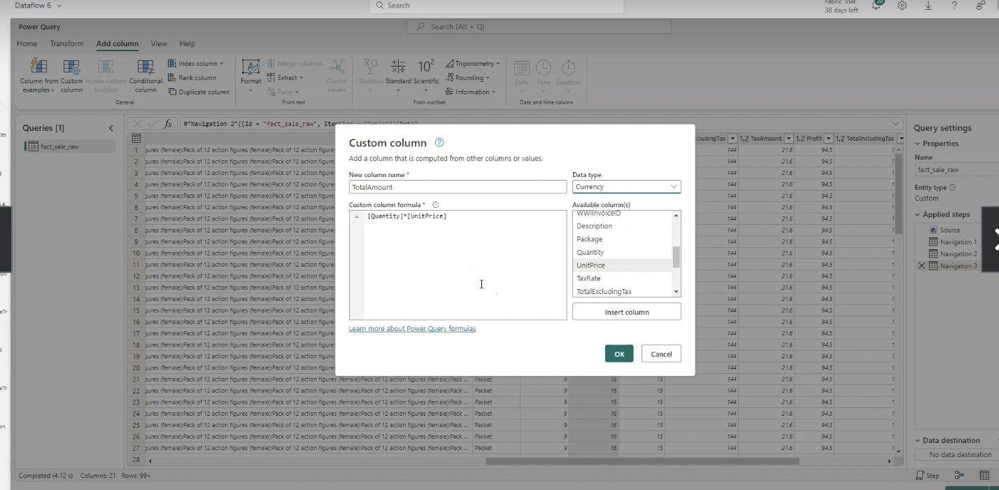

The Transformations are similar to the options available within Power BI. 

Finally data destination is setup via the GUI where lakehouse and tables are created.
* Existing or a new table is available for destination.
* If selecting existing, append or replace must be defined.



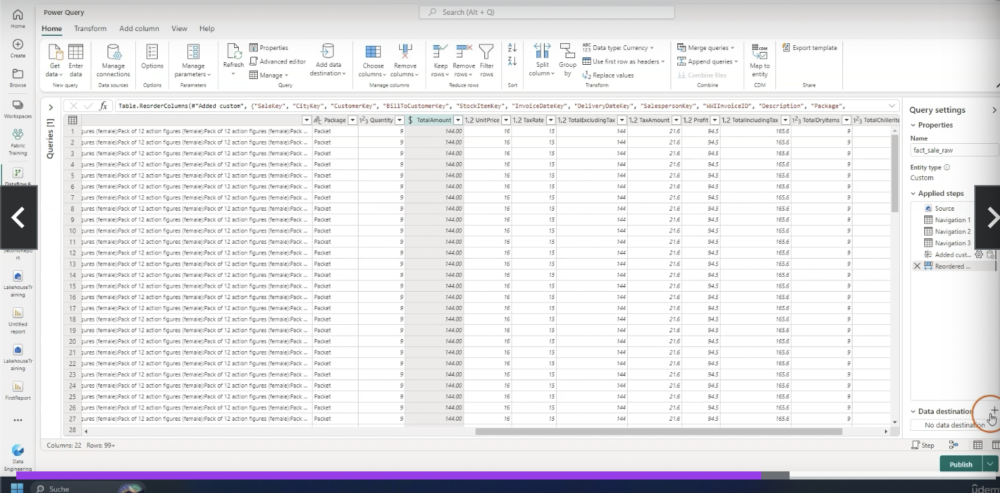


When creating a new dataflow, the pipeline must be saved to confirm the dataflow

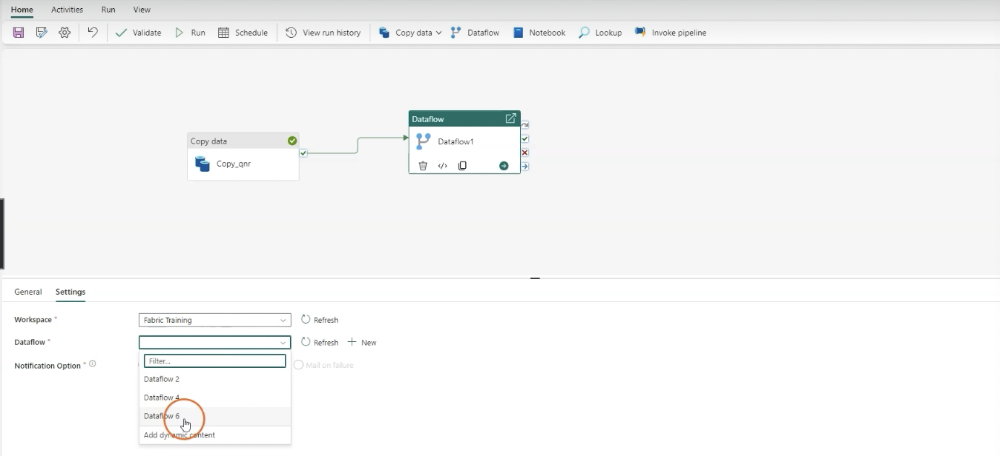


### Improving Data Flow Performance -  For Copy Not ETL

Staging can cause performance hits for larger loads of datasets depending on the source/region of the data. 

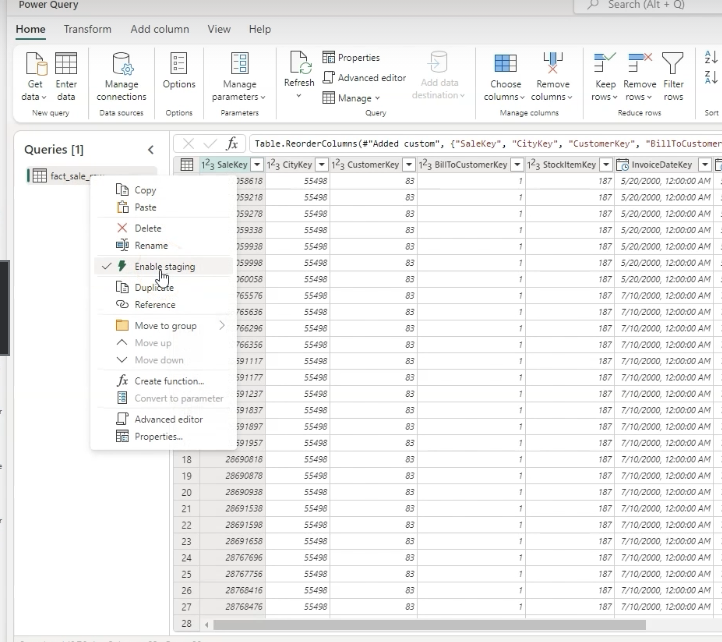


### Schedule Data Pipeline

Alternative or reoccuring options for dataflow versus one-time

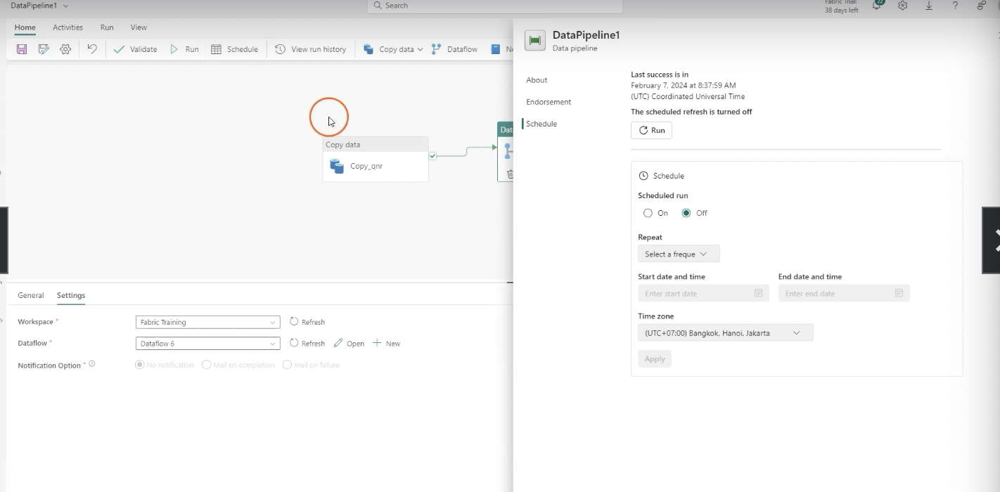

### Troubleshoot and Monitor Datapipeline

The monitoring hub includes all jobs in progress or previously ran. Under the jobs the individual activities are logged along with the associated metadata.

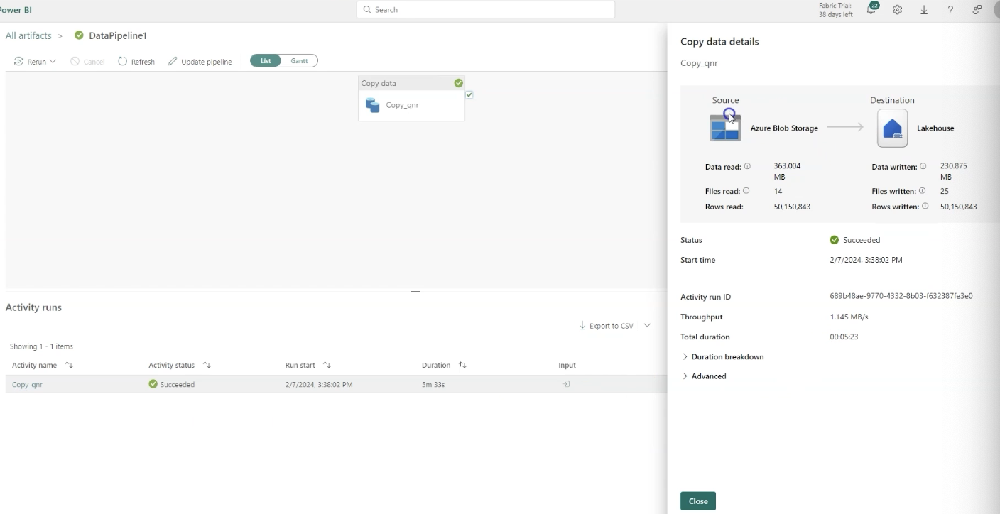


Under the activities you can toggle to a Guntt visualization to see which activities take the longest amount of time or failed.

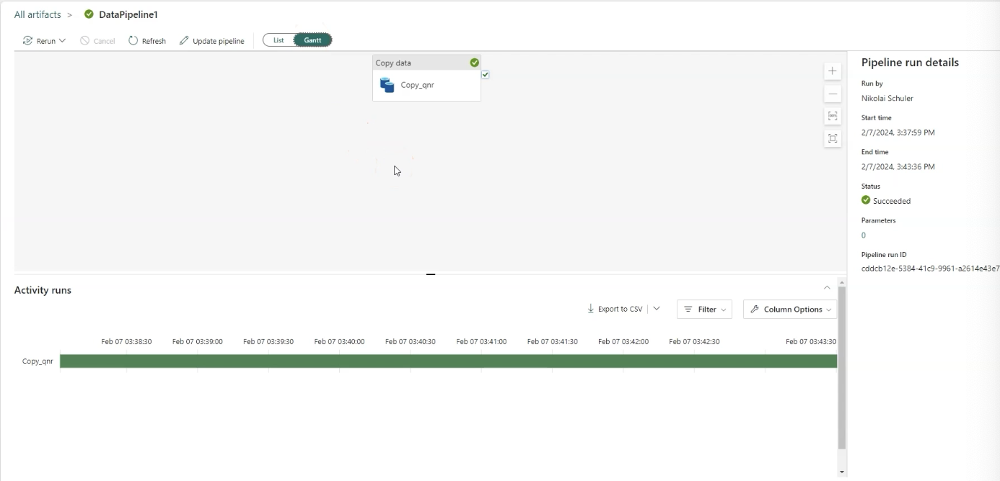





# Azure Datawarehouse

## Basics of Data Warehouse

Stores structured data unlike a lakehouse can store unstructured data, it is more rigid; more specific business intelligence use case. 
* Less complex and allows easier use for reporting or analytics
* Does not have "file support"

Lakehouse SQL Endpoints are for *read-only* access so no write operations are to be made. Any data changes must be processed through data pipelines.
* Data warehouses allow the full SQL operations with the endpoint. 

In Fabric this is a fully managed Warehouse solution with auto-scale systems. 

The delta table format is used within the warehouse just like the lakehouses (parquet format)

## Creating a Data Warehouse

Under the workspace, using the data engineering experience, the Warehouse is available for creation. 
* This is also available under different experiences

After the creation of the warehouse, T-SQL is available unlike a lakehouse along with data pipelines and flow

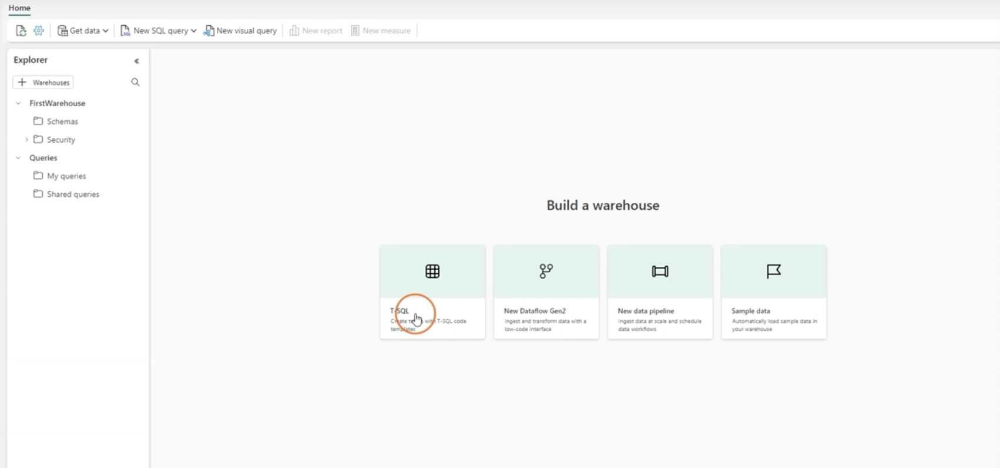

## Creating tables

Using most of the common SQL syntax is available to create and update tables/records. 
* Some data types are not available such as primary key and boolean.

Altering the table is not available so duplicating the table is required to change a given columns data type or adding a new column entirely. 

A workaround is *Create As A Select* which duplicates a given table. After the required changes, you can drop the old table.


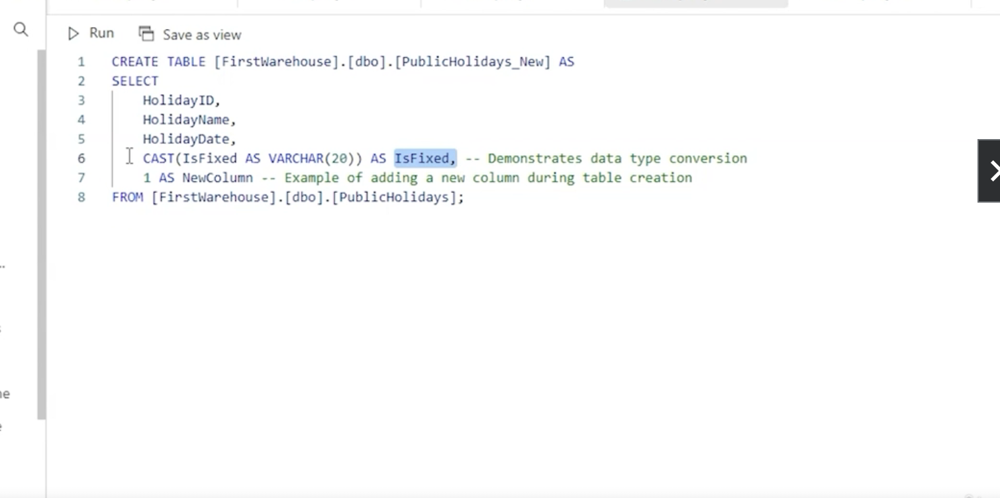

After creating the new table and dropping the old table, you must do the same thing by select creating as the original table name and dropping the "staging" table.

*Example*
1. Original table is Sales
2. Select new table with converted column is Sales_new
3. Drop original Sales table
4. Create new Sales table from Sales_new
5. Drop Sales_new





